In [1]:
import sys
import logging
from uuid import UUID

import emission.core.get_database as edb
import pandas as pd
import matplotlib.pyplot as plt
%matplotlib inline
import datetime as pydt
import emission.storage.timeseries.abstract_timeseries as esta
import emission.net.usercache.abstract_usercache as enua
import numpy as np

logging.getLogger().setLevel(logging.DEBUG)
logging.debug(sys.path)

iphone_ids = [UUID("079e0f1a-c440-3d7c-b0e7-de160f748e35"), UUID("c76a0487-7e5a-3b17-a449-47be666b36f6"), 
              UUID("c528bcd2-a88b-3e82-be62-ef4f2396967a"), UUID("95e70727-a04e-3e33-b7fe-34ab19194f8b")]
android_ids = [UUID("e471711e-bd14-3dbe-80b6-9c7d92ecc296"), UUID("fd7b4c2e-2c8b-3bfa-94f0-d1e3ecbd5fb7"),
               UUID("86842c35-da28-32ed-a90e-2da6663c5c73"), UUID("3bc0f91f-7660-34a2-b005-5c399598a369")]

DEBUG:root:['', '/Users/shankari/OSS/anaconda/lib/python2.7/site-packages/pygmaps-0.1.1-py2.7.egg', '/Users/shankari/e-mission/e-mission-server', '/Users/shankari/e-mission/data-collection-eval/analysis_spring_2016', '/Users/shankari/OSS/anaconda/python.app/Contents/lib/python27.zip', '/Users/shankari/OSS/anaconda/python.app/Contents/lib/python2.7', '/Users/shankari/OSS/anaconda/python.app/Contents/lib/python2.7/plat-darwin', '/Users/shankari/OSS/anaconda/python.app/Contents/lib/python2.7/plat-mac', '/Users/shankari/OSS/anaconda/python.app/Contents/lib/python2.7/plat-mac/lib-scriptpackages', '/Users/shankari/OSS/anaconda/python.app/Contents/lib/python2.7/lib-tk', '/Users/shankari/OSS/anaconda/python.app/Contents/lib/python2.7/lib-old', '/Users/shankari/OSS/anaconda/python.app/Contents/lib/python2.7/lib-dynload', '/Users/shankari/OSS/anaconda/lib/python2.7/site-packages/runipy-0.1.0-py2.7.egg', '/Users/shankari/OSS/anaconda/lib/python2.7/site-packages', '/Users/shankari/OSS/anaconda/lib

In [2]:
list(edb.get_timeseries_db().find({"metadata.key": "config/sensor_config", "data.battery_status": {"$exists": True}}).sort("metadata.write_ts").limit(10))

[]

In [3]:
iphone_ts = map(lambda u: esta.TimeSeries.get_time_series(u), iphone_ids)
android_ts = map(lambda u: esta.TimeSeries.get_time_series(u), android_ids)

In [4]:
ranges_df = pd.read_csv("../results_spring_2016/ranges.csv")

In [5]:
ranges_df

,start_ts,start_fmt_time,end_ts,end_fmt_time,state,android_regime,ios_regime
0,1.459279e+09,2016-03-29T12:17:14.700000-07:00,1.459288e+09,2016-03-29T14:46:54.916000-07:00,moving,high+1sec,best+1m
1,1.459288e+09,2016-03-29T14:46:54.916000-07:00,1.459301e+09,2016-03-29T18:30:30.685000-07:00,loitering,high+1sec,best+1m
2,1.459301e+09,2016-03-29T18:30:54.916000-07:00,1.459302e+09,2016-03-29T18:42:30.685000-07:00,moving,high+1sec,best+1m
3,1.459302e+09,2016-03-29T18:42:30.685000-07:00,1.459311e+09,2016-03-29T21:06:30.275000-07:00,moving,high+1sec,best+1m
4,1.459311e+09,2016-03-29T21:06:30.275000-07:00,1.459343e+09,2016-03-30T06:00:09.654643-07:00,stationary,high+1sec,best+1m
5,1.459343e+09,2016-03-30T06:00:09.654643-07:00,1.459354e+09,2016-03-30T09:00:13.859000-07:00,charging-or-full,high+1sec,best+1m
6,1.459354e+09,2016-03-30T09:00:13.859000-07:00,1.459372e+09,2016-03-30T14:01:58.965395-07:00,charging-or-full,high-v-balanced+1sec-v-30sec,best-v-10m+1m-v-30m
7,1.459372e+09,2016-03-30T14:01:58.965395-07:00,1.459372e+09,2016-03-30T14:13:55.019000-07:00,loitering,high-v-balanced+1sec-v-30sec,best-v-10m+1m-v-30m
8,1.459372e+09,2016-03-30T14:13:55.019000-07:00,1.459373e+09,2016-03-30T14:24:42.464000-07:00,moving,high-v-balanced+1sec-v-30sec,best-v-10m+1m-v-30m
9,1.459373e+09,2016-03-30T14:24:42.464000-07:00,1.459376e+09,2016-03-30T15:21:27.670000-07:00,loitering,high-v-balanced+1sec-v-30sec,best-v-10m+1m-v-30m


In [6]:
regime_grouped_ranges_df = ranges_df.groupby(['state', 'android_regime', 'ios_regime'])

In [7]:
invalid_df = pd.read_csv("../results_spring_2016/invalid.csv")

In [8]:
invalid_df

,platform,key,start_ts,start_fmt_time,end_ts,end_fmt_time
0,android,background/battery,1.459354e+09,2016-03-30T09:00:08.640000-07:00,1.459436e+09,2016-03-31T07:57:22.005000-07:00


In [9]:
import emission.analysis.point_features as pf
import attrdict as ad

In [10]:
def calDistance(row):
    return pf.calDistance(ad.AttrDict({"latitude": row[0], "longitude": row[1]}),
                          ad.AttrDict({"latitude": row[3], "longitude": row[4]}))

In [11]:
import scipy.interpolate as spi
import numpy as np

In [12]:
np.array([[1]]).shape

(1, 1)

In [13]:
def get_interp_distance_df(android_ts, ios_ts, start_ts, end_ts):
    android_df = android_ts.get_data_df("background/location", enua.UserCache.TimeQuery('write_ts', start_ts, end_ts))
    ios_df = ios_ts.get_data_df("background/location", enua.UserCache.TimeQuery('write_ts', start_ts, end_ts))
    android_latf = spi.interp1d(x=android_df.ts, y=android_df.latitude, bounds_error=False,
                                fill_value="extrapolate")
    android_lngf = spi.interp1d(x=android_df.ts, y=android_df.longitude, bounds_error=False, 
                                fill_value="extrapolate")
    ios_latf = spi.interp1d(x=ios_df.ts, y=ios_df.latitude, bounds_error=False, fill_value=(ios_df.latitude.iloc[0], ios_df.latitude.iloc[-1]))
    ios_lngf = spi.interp1d(x=ios_df.ts, y=ios_df.longitude, bounds_error=False, fill_value=(ios_df.longitude.iloc[0], ios_df.longitude.iloc[-1]))
    ts_new = np.arange(int(start_ts), int(end_ts), 1)
    fmt_time_new = map(lambda ts: pydt.datetime.fromtimestamp(ts).isoformat(), ts_new)
    interp_df = pd.DataFrame({"ts": ts_new, "fmt_time": fmt_time_new,
                            "android_lat": android_latf(ts_new), "android_lng": android_lngf(ts_new),
                            "ios_lat": ios_latf(ts_new), "ios_lng": ios_lngf(ts_new)}, index=ts_new)
    same_point_distances = np.abs(interp_df.apply(calDistance, axis=1))
    interp_df["same_point_distances"] = same_point_distances
    return interp_df

In [14]:
def get_points_from_ts_for_range(ts, start_ts, end_ts):
    return ts.get_data_df("background/location", enua.UserCache.TimeQuery('write_ts', start_ts, end_ts))

In [15]:
def get_points_for_range(ts, range_df):
    points_range_df = map(lambda row: get_points_from_ts_for_range(ts, row['start_ts'], row['end_ts']), range_df.to_dict('records'))
    return points_range_df

In [16]:
def get_points_for_group(ts_list, range_df):
    return map(lambda ts: get_points_for_range(ts, range_df), ts_list)

In [17]:
iphone_high_fast_stationary_df = pd.DataFrame()
for key, df in regime_grouped_ranges_df:
    if key[0] == 'stationary' and key[1] == 'high+1sec':
        # one row for each phone
        # each row contains len(stationary ranges) dataframes
        iphone_range_location_df_list = get_points_for_group(iphone_ts, df)

DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459310790.275, '$lt': 1459342809.654}, 'user_id': UUID('079e0f1a-c440-3d7c-b0e7-de160f748e35')}, sort_key = metadata.write_ts
DEBUG:root:Found 42 results
DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459310790.275, '$lt': 1459342809.654}, 'user_id': UUID('c76a0487-7e5a-3b17-a449-47be666b36f6')}, sort_key = metadata.write_ts
DEBUG:root:Found 41 results
DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459310790.275, '$lt': 1459342809.654}, 'user_id': UUID('c528bcd2-a88b-3e82-be62-ef4f2396967a')}, sort_key = metadata.write_ts
DEBUG:root:Found 79 results
DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459310790.275, '$lt': 1459342809.654}, 'user_id': UUID('95e70727-a04e-3e33-b7fe-34ab19194f8b')}, sort_key = metada

In [18]:
android_high_fast_stationary_df = pd.DataFrame()
for key, df in regime_grouped_ranges_df:
    if key[0] == 'stationary' and key[1] == 'high+1sec':
        # one row for each phone
        # each row contains len(stationary ranges) dataframes
        android_phone_range_location_df_list = get_points_for_group(android_ts, df)

DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459310790.275, '$lt': 1459342809.654}, 'user_id': UUID('e471711e-bd14-3dbe-80b6-9c7d92ecc296')}, sort_key = metadata.write_ts
DEBUG:root:Found 32006 results
DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459310790.275, '$lt': 1459342809.654}, 'user_id': UUID('fd7b4c2e-2c8b-3bfa-94f0-d1e3ecbd5fb7')}, sort_key = metadata.write_ts
DEBUG:root:Found 32002 results
DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459310790.275, '$lt': 1459342809.654}, 'user_id': UUID('86842c35-da28-32ed-a90e-2da6663c5c73')}, sort_key = metadata.write_ts
DEBUG:root:Found 32003 results
DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459310790.275, '$lt': 1459342809.654}, 'user_id': UUID('3bc0f91f-7660-34a2-b005-5c399598a369')}, sort_key

In [19]:
import emission.analysis.plotting.leaflet_osm.our_plotter as lo
import emission.analysis.plotting.geojson.geojson_feature_converter as gfc
import emission.analysis.plotting.leaflet_osm.ipython_helper as ipy

In [20]:
ipy.inline_maps([lo.get_maps_for_geojson_unsectioned([gfc.get_feature_list_from_df(iphone_range_location_df_list[0][0])]) + 
                 lo.get_maps_for_geojson_unsectioned([gfc.get_feature_list_from_df(android_phone_range_location_df_list[0][0].sample(frac=0.01))])])

DEBUG:root:Getting midpoint of (-122.0864971542005, 37.39102237861361) and (-122.0865052008276, 37.39109148740526)


Found 42 points
Found 320 points

DEBUG:root:Getting midpoint of (-122.0865351, 37.391037) and (-122.0865035, 37.3910956)


In [21]:
iphone_high_fast_loitering_df = pd.DataFrame()
for key, df in regime_grouped_ranges_df:
    if key[0] == 'loitering' and key[1] == 'high+1sec':
        # one row for each phone
        # each row contains len(stationary ranges) dataframes
        iphone_range_location_df_list = get_points_for_group(iphone_ts, df)

DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459288014.9160001, '$lt': 1459301430.685}, 'user_id': UUID('079e0f1a-c440-3d7c-b0e7-de160f748e35')}, sort_key = metadata.write_ts
DEBUG:root:Found 180 results
DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459799901.0, '$lt': 1459832671.0}, 'user_id': UUID('079e0f1a-c440-3d7c-b0e7-de160f748e35')}, sort_key = metadata.write_ts
DEBUG:root:Found 0 results
DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459288014.9160001, '$lt': 1459301430.685}, 'user_id': UUID('c76a0487-7e5a-3b17-a449-47be666b36f6')}, sort_key = metadata.write_ts
DEBUG:root:Found 131 results
DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459799901.0, '$lt': 1459832671.0}, 'user_id': UUID('c76a0487-7e5a-3b17-a449-47be666b36f6')}, sort_key = metad

In [22]:
android_high_fast_loitering_df = pd.DataFrame()
for key, df in regime_grouped_ranges_df:
    if key[0] == 'loitering' and key[1] == 'high+1sec':
        # one row for each phone
        # each row contains len(stationary ranges) dataframes
        android_phone_range_location_df_list = get_points_for_group(android_ts, df)

DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459288014.9160001, '$lt': 1459301430.685}, 'user_id': UUID('e471711e-bd14-3dbe-80b6-9c7d92ecc296')}, sort_key = metadata.write_ts
DEBUG:root:Found 9763 results
DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459799901.0, '$lt': 1459832671.0}, 'user_id': UUID('e471711e-bd14-3dbe-80b6-9c7d92ecc296')}, sort_key = metadata.write_ts
DEBUG:root:Found 0 results
DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459288014.9160001, '$lt': 1459301430.685}, 'user_id': UUID('fd7b4c2e-2c8b-3bfa-94f0-d1e3ecbd5fb7')}, sort_key = metadata.write_ts
DEBUG:root:Found 9355 results
DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459799901.0, '$lt': 1459832671.0}, 'user_id': UUID('fd7b4c2e-2c8b-3bfa-94f0-d1e3ecbd5fb7')}, sort_key = met

In [23]:
reload(gfc)

<module 'emission.analysis.plotting.geojson.geojson_feature_converter' from '/Users/shankari/e-mission/e-mission-server/emission/analysis/plotting/geojson/geojson_feature_converter.pyc'>

In [24]:
ipy.inline_maps([lo.get_maps_for_geojson_unsectioned([gfc.get_feature_list_from_df(iphone_range_location_df_list[0][0])]) + 
                 lo.get_maps_for_geojson_unsectioned([gfc.get_feature_list_from_df(android_phone_range_location_df_list[0][0].sample(frac=0.1))])])

DEBUG:root:Getting midpoint of (-122.2590450012332, 37.87540032531868) and (-122.258729841674, 37.87533603612135)


Found 180 points
Found 976 points

DEBUG:root:Getting midpoint of (-122.2586239, 37.8754253) and (-122.2588256, 37.8753593)


In [25]:
time_df = android_phone_range_location_df_list[0][0]
interp_df = get_interp_distance_df(android_ts[0], iphone_ts[0], time_df.iloc[0].ts, time_df.iloc[-1].ts)

DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459288015.402, '$lt': 1459301430.0}, 'user_id': UUID('e471711e-bd14-3dbe-80b6-9c7d92ecc296')}, sort_key = metadata.write_ts
DEBUG:root:Found 9762 results
DEBUG:root:curr_query = {'$or': [{'metadata.key': 'background/location'}], 'metadata.write_ts': {'$gte': 1459288015.402, '$lt': 1459301430.0}, 'user_id': UUID('079e0f1a-c440-3d7c-b0e7-de160f748e35')}, sort_key = metadata.write_ts
DEBUG:root:Found 179 results


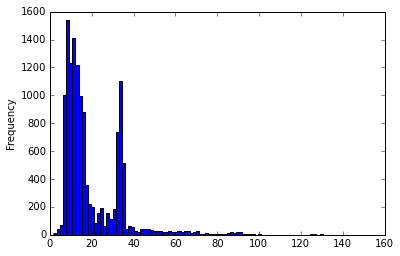

In [26]:
interp_df.same_point_distances.plot(kind='hist', bins = 100)

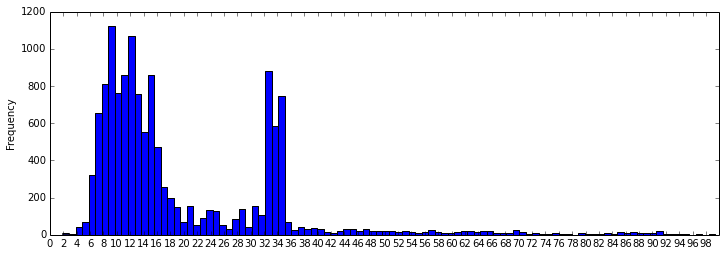

In [27]:
ax = interp_df[interp_df.same_point_distances < 100].same_point_distances.plot(kind='hist', bins = 100, figsize=(12,4))
tick_list = ax.set_xticks(np.arange(0,100,2))

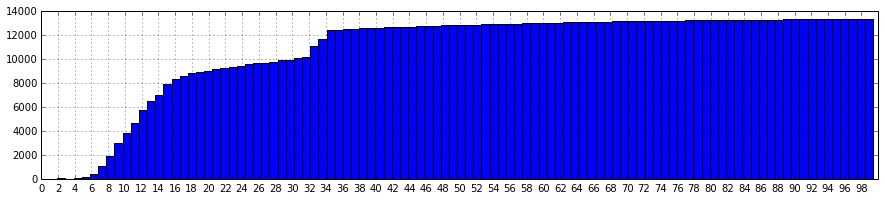

In [38]:
ax = interp_df[interp_df.same_point_distances < 100].same_point_distances.hist(bins=100, figsize=(15,3), cumulative=True)
tick_list = ax.set_xticks(np.arange(0,100,2))

In [43]:
ipy.inline_maps([lo.get_maps_for_geojson_unsectioned([gfc.get_feature_list_from_df(interp_df, ts="ts", latitude="ios_lat", longitude="ios_lng")]) +
lo.get_maps_for_geojson_unsectioned([gfc.get_feature_list_from_df(interp_df, ts="ts", latitude="android_lat", longitude="android_lng")])])

DEBUG:root:Getting midpoint of (-122.2590380442536, 37.87540874913137) and (-122.258729841674, 37.87533603612135)


Found 13415 points
Found 13415 points

DEBUG:root:Getting midpoint of (-122.25897036942987, 37.87539448481629) and (-122.2591438, 37.8761136)


In [31]:
cleaned_stationary_df_20 = interp_df[interp_df.same_point_distances <= 20]

In [35]:
ipy.inline_maps([lo.get_maps_for_geojson_unsectioned([gfc.get_feature_list_from_df(cleaned_stationary_df_20.sample(frac=0.1), ts="ts", latitude="android_lat", longitude="android_lng")]) +
lo.get_maps_for_geojson_unsectioned([gfc.get_feature_list_from_df(cleaned_stationary_df_20.sample(frac=0.1), ts="ts", latitude="ios_lat", longitude="ios_lng")])])

DEBUG:root:Getting midpoint of (-122.258715, 37.8755321) and (-122.25917130360072, 37.87536587345289)


Found 899 points
Found 899 points

DEBUG:root:Getting midpoint of (-122.25918119657688, 37.87542254688372) and (-122.25868736750282, 37.875341266397605)


In [40]:
cleaned_stationary_df_18 = interp_df[interp_df.same_point_distances <= 18]

In [41]:
ipy.inline_maps([lo.get_maps_for_geojson_unsectioned([gfc.get_feature_list_from_df(cleaned_stationary_df_18, ts="ts", latitude="android_lat", longitude="android_lng")]) +
lo.get_maps_for_geojson_unsectioned([gfc.get_feature_list_from_df(cleaned_stationary_df_18, ts="ts", latitude="ios_lat", longitude="ios_lng")])])

DEBUG:root:Getting midpoint of (-122.25897036942987, 37.87539448481629) and (-122.25882866045099, 37.87536917141128)


Found 8719 points
Found 8719 points

DEBUG:root:Getting midpoint of (-122.2590380442536, 37.87540874913137) and (-122.258729841674, 37.87533603612135)
